<a href="https://colab.research.google.com/github/Somu112/Machine-Learning/blob/main/Cluster_MarketAnalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Scenario: Unsupervised Learning: Customer Market Segmentation**

The marketing department of any enterprise is responsible for promoting the products, ideas and mission of the enterprise, finding new customers, and reminding existing customers that you are in business

###Problem Statement:

You have been hired as a Data Scientist and have to perform Customer Market Segementation which will help the bank's marketing team to launch a targetted marketing ad campaign that is tailored to a specific group of customers. In simple words, the bank wants to divide their customers into atleast different groups for the ad-campaign to be successful

This process is called Market Segmentation and it is crucial for maximizing marketing campaign conversion rate

###Aim:

In this demo, you have to build a clustering model to divide customer's into distinctive groups

###Dataset Description: The data set contains the following attributes:

  * CUST_ID - Identification of Credit Card holder (Categorical)
  * BALANCE - Balance amount left in their account to make purchases
  * BALANCE_FREQUENCY - How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
  * PURCHASES - Amount of purchases made from account
  * ONEOFF_PURCHASES - Maximum purchase amount done in one-go
  * INSTALLMENTS_PURCHASES - Amount of purchase done in installment
  * CASH_ADVANCE - Cash in advance given by the user
  * PURCHASES_FREQUENCY - How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
  * ONEOFF_PURCHASES_FREQUENCY - How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
  * PURCHASES_INSTALLMENTS_FREQUENCY - How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
  * CASH_ADVANCE_FREQUENCY - How frequently the cash in advance being paid
  * CASH_ADVANCE_TRX - Number of Transactions made with "Cash in Advanced"
  * PURCHASES_TRX - Number of purchase transactions made
  * CREDIT_LIMIT - Limit of Credit Card for user
  * PAYMENTS - Amount of Payment done by user
  * MINIMUM_PAYMENTS - Minimum amount of payments made by user
  * PRC_FULL_PAYMENT - Percent of full payment paid by user
  * TENURE - Tenure of credit card service for user

###Tasks to be performed:

  * Import required libraries and load the data set from Dropbox

  * Perform Exploratory Data Analysis (EDA) on the data set

    * Generate a Data Report using Pandas Profiling and record your observations

    * Plot Univariate Distributions

      * What is the distribution of the Purchase & Purchases Frequency columns in the data set?
      * What's the tenure of the credit card service for user?

    * Plot Bi-Variate Distributions

      * How does the tenure of a credit card user affect its purchases?
      * Analyse the data set for outliers using a Box Plot

  * Pre-process that data set for modeling

    * Handle Missing values present in the data set
    * Deal with extreme values
    * Perform scaling on the data set using StandardScaler

  * Modelling

    * Build a K-Means Clustering Model and then, apply PCA to visualize the clusters and use Elbow Method to find optimal value of K
    * Build a Hierarchial Model
    * Build a DBSCAN Model
    * Build a Spectral Clustering Model

  * Use PyCaret to build and analyze the models:

    * Import PyCaret and load the data set
    * Initialize or setup the environment
    * Compare Multiple Models and their Accuracy Metrics
    * Create the model
    * Assign the model
    * Plot the model

###Install the required dependencies, import the required libraries and load the data set

####Installing Dependencies

**Note:** After Insalling Pandas Profiling, restart the kernel and run from the top excluding the installation cell

  * It's better to install all th libraries at the top

In [1]:
!wget https://www.dropbox.com/s/6v54wro81mlyp4x/marketing_data.csv

--2021-11-05 01:10:39--  https://www.dropbox.com/s/6v54wro81mlyp4x/marketing_data.csv
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/6v54wro81mlyp4x/marketing_data.csv [following]
--2021-11-05 01:10:39--  https://www.dropbox.com/s/raw/6v54wro81mlyp4x/marketing_data.csv
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc03382c274f2baf51ab21bf50bd.dl.dropboxusercontent.com/cd/0/inline/BZWsBIq8hTP25hAuLWPfmfUmnimh_iav2BdBKEiCpC5m8sBEw8GSTXAaFA4AL5k-gq-yOgBQ-8ovhP9SgR0iu82QDK49Ud-ocaRiF7_E6R7NAlV80U7hElNS0X9CpdO1pqtsJDCPU56GBUm-Sox6Baav/file# [following]
--2021-11-05 01:10:39--  https://uc03382c274f2baf51ab21bf50bd.dl.dropboxusercontent.com/cd/0/inline/BZWsBIq8hTP25hAuLWPfmfUmnimh_iav2BdBKEiCpC5m8sBEw8GSTXAaFA4AL5k-gq-yOgBQ

In [2]:
#Intalling Pandas-Profiling
!pip install pandas-profiling==2.7.1 --quiet    --disable-pip-version-check

In [3]:
! pip show pandas-profiling

Name: pandas-profiling
Version: 2.7.1
Summary: Generate profile report for pandas DataFrame
Home-page: https://github.com/pandas-profiling/pandas-profiling
Author: Simon Brugman
Author-email: pandasprofiling@gmail.com
License: MIT
Location: /usr/local/lib/python3.7/dist-packages
Requires: htmlmin, joblib, phik, missingno, visions, jinja2, scipy, confuse, matplotlib, astropy, numpy, ipywidgets, pandas, requests, tangled-up-in-unicode, tqdm
Required-by: 


###Importing Required Libraries

In [4]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering

from sklearn.metrics import accuracy_score, confusion_matrix

from pandas_profiling import ProfileReport
sns.set()

import warnings
warnings.filterwarnings("ignore")
import os

print("Library imported")

Library imported


In [5]:
df = pd.read_csv("marketing_data.csv")
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


###Exploratory Data Analysis

In [6]:
import pandas_profiling
from pandas_profiling import ProfileReport
prof = ProfileReport(df)
prof.to_file(output_file='output.html')

Summarize dataset:   0%|          | 0/30 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
ProfileReport(df).to_notebook_iframe()

Summarize dataset:   0%|          | 0/30 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Type Markdown and LaTeX:  𝛼2 

####Plotting Univariate Distributions A Univariate distribution is a probability distribution of only one random variable

Note: You have already seen this in Pandas Profiling. Still, if you want to write the code, you can do so.

What is the distribution of the Purchase & Purchases Frequency columns in the data set?

In [8]:
import plotly.express as px
fig = px.histogram(df, x = "PURCHASES")
fig.show()

***Observations:***

  * Most of the customers do not make any purchase using the credit card while a large number of them spend aroung 300-700
  * Very few customers spend more than a thousand using a credit card

In [9]:
fig = px.histogram(df, x = "PURCHASES_FREQUENCY")
fig.show()

What's the tenure of the credit card service for user?

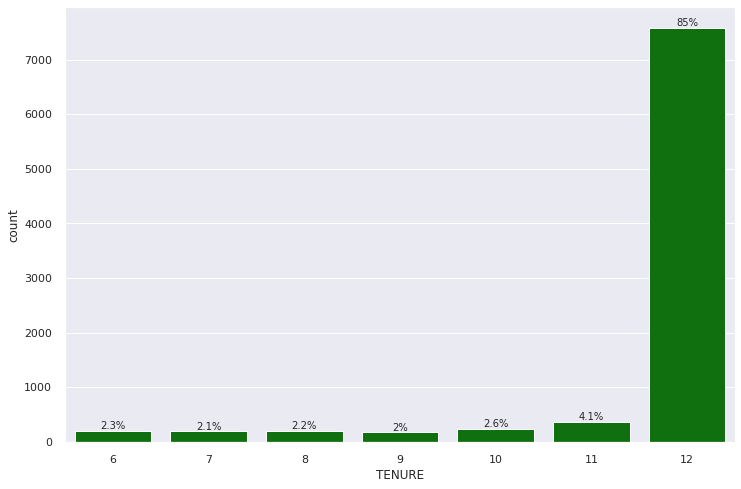

In [10]:
%matplotlib inline
plt.figure(figsize=(12,8))

ax = sns.countplot(df["TENURE"], color='green')
for p in ax.patches:
  x = p.get_bbox().get_points()[:,0]

  y = p.get_bbox().get_points()[1,1]
  
  ax.annotate('{:.2g}%'.format(100.*y/len(df)), (x.mean(), y), ha='center', va='bottom')
plt.show() 

***Observations:***
  * Most of the credit card users have been utilizing the service for 12 years now
  

In [11]:
df.columns

Index(['CUST_ID', 'BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE'],
      dtype='object')

####Bi-variate Distributions
  * A Bi-Variate distribution is a distribution of two random variables
  * The concept generalizes to any number of random variables. giving a Multivariate Distribution

How does the tenure of credit card user affect its purchases?

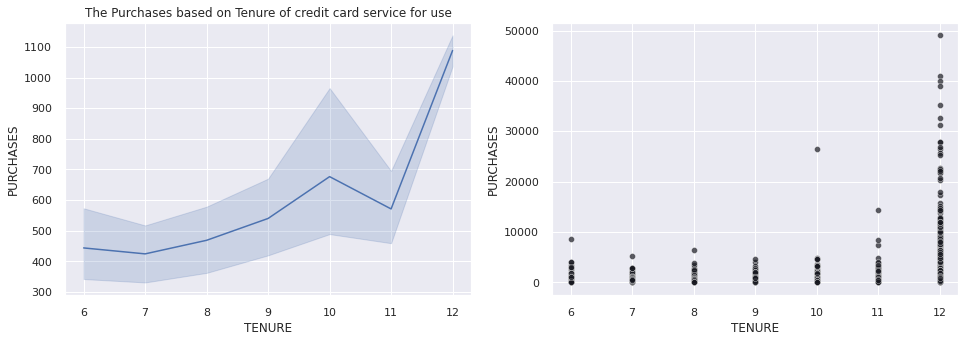

In [12]:
plt.figure(figsize=(16,5))

plt.subplot(1,2,1)
sns.lineplot(x='TENURE',y='PURCHASES',data=df)
plt.title('The Purchases based on Tenure of credit card service for use')

plt.subplot(1,2,2)
sns.scatterplot(y='PURCHASES',x='TENURE',data = df,color='#171820',alpha=0.7)
plt.show()

**Observations:**

  * From above, we can observe that increase in the period of use of the card, the purchase price increases, especially for a year


Analyze the dataset for outliers using a Box plot

In [13]:
lt = []
for i in df.drop('CUST_ID', axis=1).columns:
  lt.append(i)

lt

['BALANCE',
 'BALANCE_FREQUENCY',
 'PURCHASES',
 'ONEOFF_PURCHASES',
 'INSTALLMENTS_PURCHASES',
 'CASH_ADVANCE',
 'PURCHASES_FREQUENCY',
 'ONEOFF_PURCHASES_FREQUENCY',
 'PURCHASES_INSTALLMENTS_FREQUENCY',
 'CASH_ADVANCE_FREQUENCY',
 'CASH_ADVANCE_TRX',
 'PURCHASES_TRX',
 'CREDIT_LIMIT',
 'PAYMENTS',
 'MINIMUM_PAYMENTS',
 'PRC_FULL_PAYMENT',
 'TENURE']

In [14]:
plt.figure(figsize=(30,30))

for idx,val in enumerate(lt):
  fig = px.box(df, y = val)
  fig.show()

<Figure size 2160x2160 with 0 Axes>

***Observations:***

  * Many columns in the data set contains outliers. We will deal with them in the Data Pre-preprocessing step

###Data Pre-processing

Handle Missing Values present in the data set

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [16]:
df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [17]:
df['MINIMUM_PAYMENTS'] = df.MINIMUM_PAYMENTS.fillna(df.MINIMUM_PAYMENTS.mean())

In [18]:
df['CREDIT_LIMIT'] = df.CREDIT_LIMIT.fillna(df.CREDIT_LIMIT.mean())

In [19]:
df.isnull().sum()

CUST_ID                             0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

In [20]:
df.drop('CUST_ID', axis=1, inplace=True)

***Checking for correlation using heatmap***

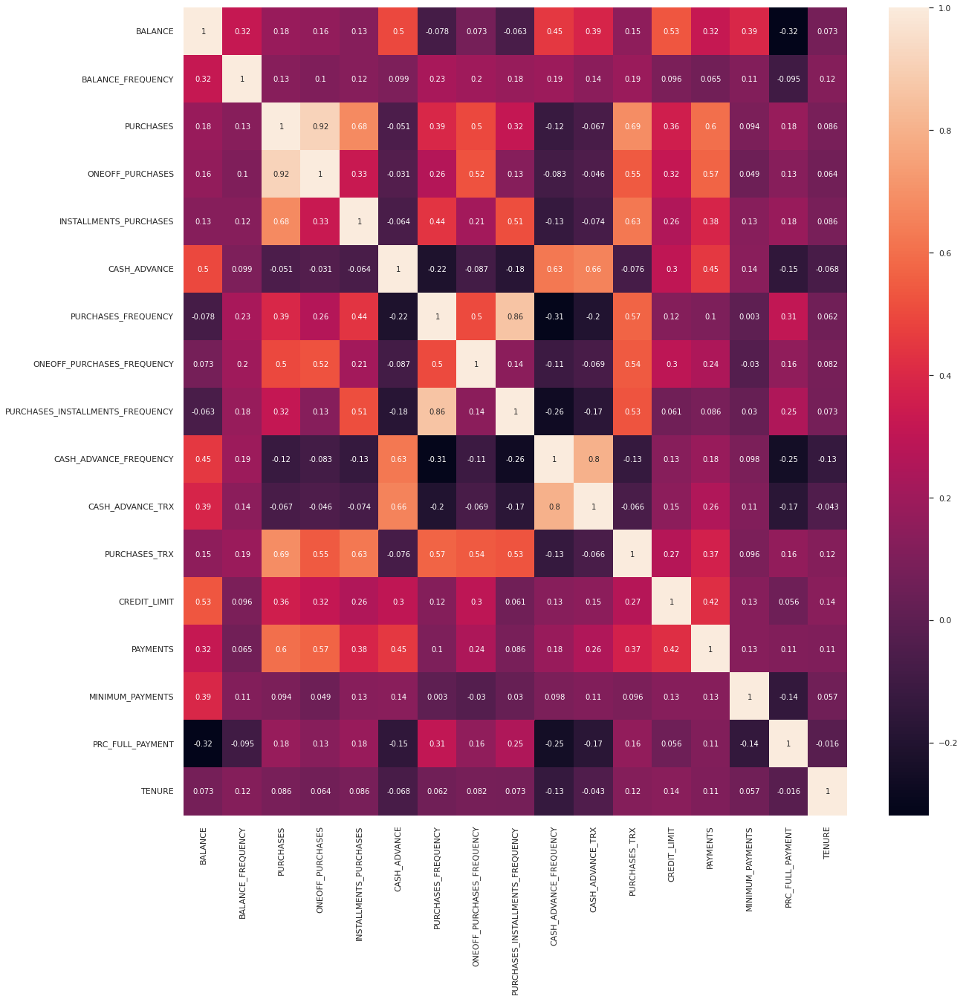

In [21]:
corr=df.corr()
top_features=corr.index
plt.figure(figsize=(20,20))
sns.heatmap(df[top_features].corr(),annot=True)

Removing highly correlated features(correlation>=0.8)

In [22]:
df.drop(['PURCHASES','PURCHASES_FREQUENCY','CASH_ADVANCE_FREQUENCY'],axis=1,inplace=True)

Let us take care of outliers

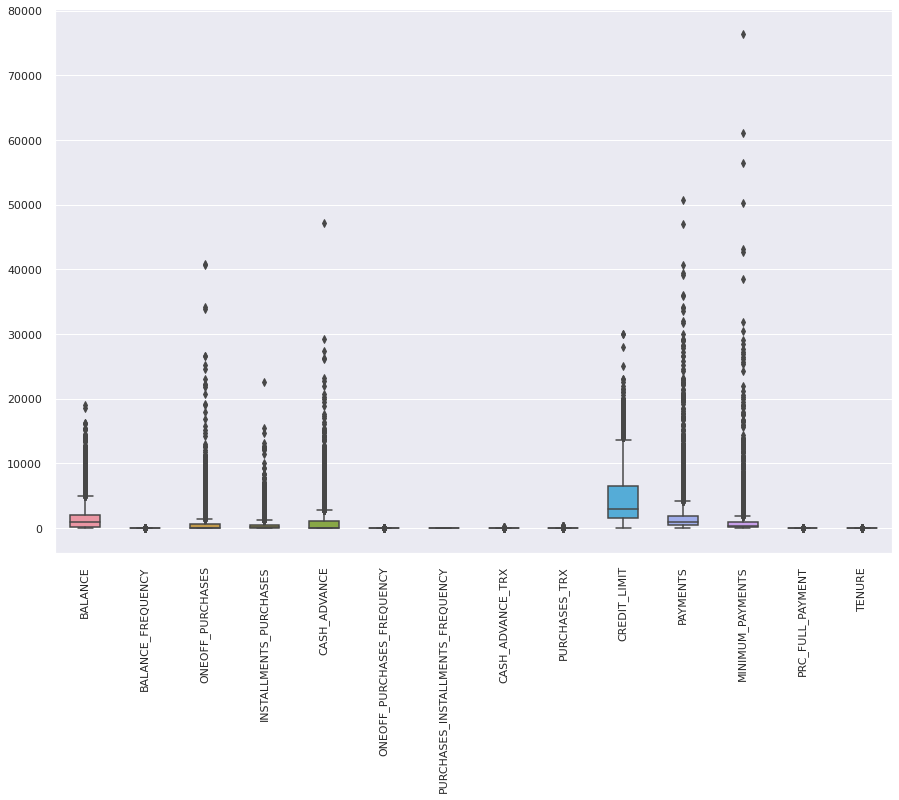

In [23]:
fig, ax = plt.subplots(figsize=(15,10))
sns.boxplot(data=df, width=0.5, ax=ax)
plt.xticks(rotation=90)
plt.show()

let us use Z-Score to take care of outliers

In [24]:
from scipy import stats
import numpy as np
z = np.abs(stats.zscore(df))
print(z)

       BALANCE  BALANCE_FREQUENCY  ...  PRC_FULL_PAYMENT    TENURE
0     0.731989           0.249434  ...          0.525551  0.360680
1     0.786961           0.134325  ...          0.234227  0.360680
2     0.447135           0.518084  ...          0.525551  0.360680
3     0.049099           1.016953  ...          0.525551  0.360680
4     0.358775           0.518084  ...          0.525551  0.360680
...        ...                ...  ...               ...       ...
8945  0.737950           0.518084  ...          1.183951  4.122768
8946  0.742423           0.518084  ...          0.525551  4.122768
8947  0.740398           0.185477  ...          0.329200  4.122768
8948  0.745174           0.185477  ...          0.329200  4.122768
8949  0.572575           0.889033  ...          0.525551  4.122768

[8950 rows x 14 columns]


In [25]:
threshold = 3
print(np.where(z>3))

(array([   6,   19,   20, ..., 8947, 8948, 8949]), array([ 2, 11, 11, ..., 13, 13, 13]))


In [26]:
df1 = df[(z<3).all(axis=1)]

print("Size of dataframe before outlier removal:", df.shape)
print("Size of dataframe after outlier removal:", df1.shape)

Size of dataframe before outlier removal: (8950, 14)
Size of dataframe after outlier removal: (7507, 14)


From Pandas Profiling, we saw that there is a lot skewness in columns:

* BALANCE
* ONEOFF_PURCHASES
* INSTALLMENTS_PURCHASES
* CASH_ADVANCE
* CASH_ADVANCE_TRX
* PURCHASES_TRX
* CREDIT_LIMIT
* PAYMENTS
* MINIMUM_PAYMENTS

In [27]:
lt = ['BALANCE','ONEOFF_PURCHASES','INSTALLMENTS_PURCHASES','CASH_ADVANCE','CASH_ADVANCE_TRX','PURCHASES_TRX','CREDIT_LIMIT','PAYMENTS','MINIMUM_PAYMENTS']
for i in lt:
  df1[i] = np.log(1 + df1[i])

In [28]:
df1.head()

,BALANCE,BALANCE_FREQUENCY,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,3.735304,0.818182,0.000000,4.568506,0.000000,0.000000,0.083333,0.000000,1.098612,6.908755,5.312231,4.945277,0.000000,12
1,8.071989,0.909091,0.000000,0.000000,8.770896,0.000000,0.000000,1.609438,0.000000,8.853808,8.319725,6.978531,0.222222,12
2,7.822504,1.000000,6.651791,0.000000,0.000000,1.000000,0.000000,0.000000,2.564949,8.922792,6.434654,6.442994,0.000000,12
3,7.419183,0.636364,7.313220,0.000000,5.331694,0.083333,0.000000,0.693147,0.693147,8.922792,0.000000,6.762968,0.000000,12
4,6.707735,1.000000,2.833213,0.000000,0.000000,0.083333,0.000000,0.000000,0.693147,7.090910,6.521114,5.504483,0.000000,12


Scale the data set using StandardScaler

In [29]:
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df1)

In [30]:
df_scaled.shape

(7507, 14)

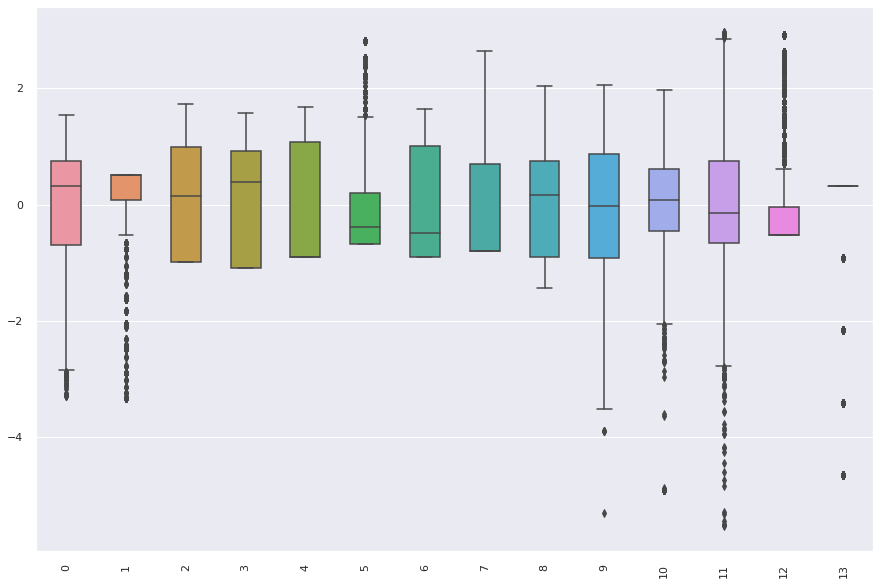

In [31]:
fig, ax = plt.subplots(figsize=(15,10))
sns.boxplot(data=df_scaled, width=0.5, ax=ax)
plt.xticks(rotation=90)
plt.show()

###Model Building

###K-Means Clustering

***K-Means Clustering***

  * Unsupervised Learning Algorithm
  * Used to group some data points together (Clustering) in an Unsupervised fashion
  * Groups observations with similar attribute values together by measuring the Euclidean distance between points

A cluster refers to a collection of data points clubbed together because of existing similarities between them. The task of identifying and assigning similar data-points to a cluster is known as Clustering.

Steps in K-Means Algorithm:

Step 1 : Select the number of clusters you want to indentify i.e. the K.

Step 2 :Randomly select K different or distinct data points as centroids .

Step 3 :Calculate Distance (Euclidean, Manhattan, and Cosine, etc) and assign each data-point to the closest cluster centroid.

Step 4 : Calculate the centroid of all the newly-formed clusters.

Step 5 : Repeat steps 3 and 4 until the stopping criteria is met.

***Stopping Criteria***

We stop the K-Means Clustering Algorithm when the centroids of the clusters are not changing at all even after multiple iterations. That means the algorithm is not finding any new patterns.

The algorithm will stop the training once the maximum number of iterations has reached. For example - if you set the maximum number of iterations as 30, the algorithm will stop after 30 iterations.

If you want to learn more about K-Means, Click Here!

Let us say you work at a bank, the customers provide you with features such as Age and Savings (How much did they save?).

Now, you want to cluster these customers into different groups

In [32]:
#Here, we are assuming the value of k as 3

kmeans = KMeans(n_clusters=3)

kmeans.fit(df_scaled)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=3, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [33]:
labels = kmeans.labels_
print(labels)

[2 0 1 ... 0 2 0]


In [34]:
kmeans.cluster_centers_.shape

(3, 14)

In [35]:
cluster_centres = pd.DataFrame(data=kmeans.cluster_centers_,columns=[df.columns])
cluster_centres

,BALANCE,BALANCE_FREQUENCY,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,0.597667,0.221375,-0.489011,-0.849715,0.917607,-0.492635,-0.764468,0.852939,-0.985775,-0.102785,-0.019482,0.448065,-0.442814,-0.118969
1,0.377944,0.414364,0.861085,0.549155,-0.282644,0.891624,0.476476,-0.271088,0.886965,0.321310,0.419617,0.281744,-0.048602,0.179990
2,-1.196040,-0.770826,-0.419670,0.402328,-0.805318,-0.451642,0.382975,-0.738571,0.168204,-0.255860,-0.477080,-0.894751,0.609658,-0.066854


These are the centroids for all of these different features. The problem with the above data frame is that the data is already scaled. Let's apply inverse transform to scale the data back to it's original values

In [36]:
cluster_centres = scaler.inverse_transform(cluster_centres)
cluster_centres = pd.DataFrame(data = cluster_centres, columns=[df.columns])

cluster_centres


,BALANCE,BALANCE_FREQUENCY,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,7.210154,0.937677,1.588735,0.728234,6.265803,0.050756,0.056559,1.524603,0.579310,7.943029,6.564742,6.305345,0.024947,11.650478
1,6.803729,0.978705,5.863837,4.952360,2.129895,0.448546,0.543471,0.487647,3.009491,8.269959,7.153483,6.130592,0.139267,11.891446
2,3.892317,0.726742,1.808304,4.508990,0.328829,0.062536,0.506784,0.056376,2.076784,7.825025,5.951197,4.894455,0.330160,11.692484


***Observations:***

* Cluster 1:
  * Customers with high credit limit purchases more frequently
  * These customers purchase items in installments
  * They make the highest full payment in percentage and has been a credit card user for a very long time now

NOTE:: Similarly, write observations for the remaining two clusters

* **Cluster 2:**
  * 
  *
* **Cluster 3:**
  
  *
  *


In [37]:
y_kmeans = kmeans.fit_predict(df_scaled)
y_kmeans

array([2, 1, 0, ..., 1, 2, 1], dtype=int32)

In [38]:
#concatenate the cluster labels to our Original DataFrame

df_cluster = pd.concat([df, pd.DataFrame({'cluster':labels})], axis=1)
df_cluster.head()

,BALANCE,BALANCE_FREQUENCY,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,0.00,95.4,0.000000,0.000000,0.083333,0,2,1000.0,201.802084,139.509787,0.000000,12,2.0
1,3202.467416,0.909091,0.00,0.0,6442.945483,0.000000,0.000000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0.0
2,2495.148862,1.000000,773.17,0.0,0.000000,1.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,1.0
3,1666.670542,0.636364,1499.00,0.0,205.788017,0.083333,0.000000,1,1,7500.0,0.000000,864.206542,0.000000,12,0.0
4,817.714335,1.000000,16.00,0.0,0.000000,0.083333,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0.0


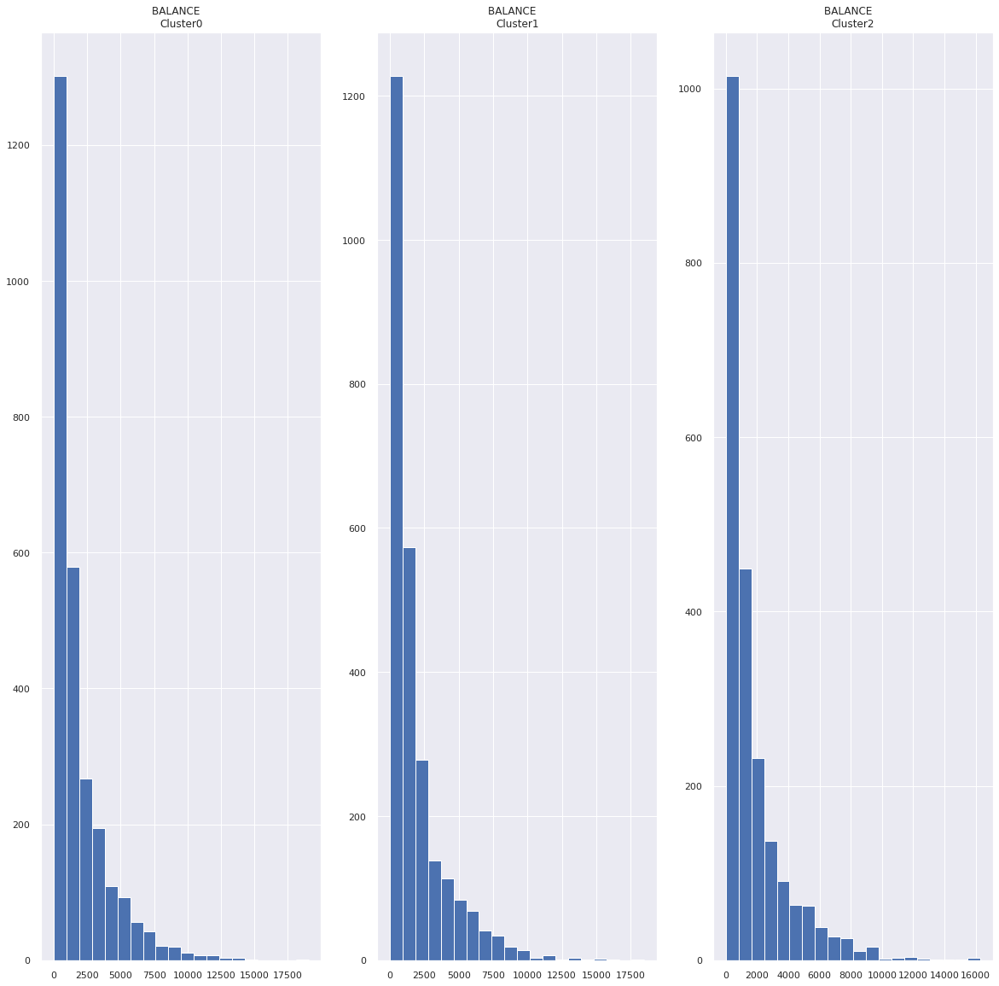

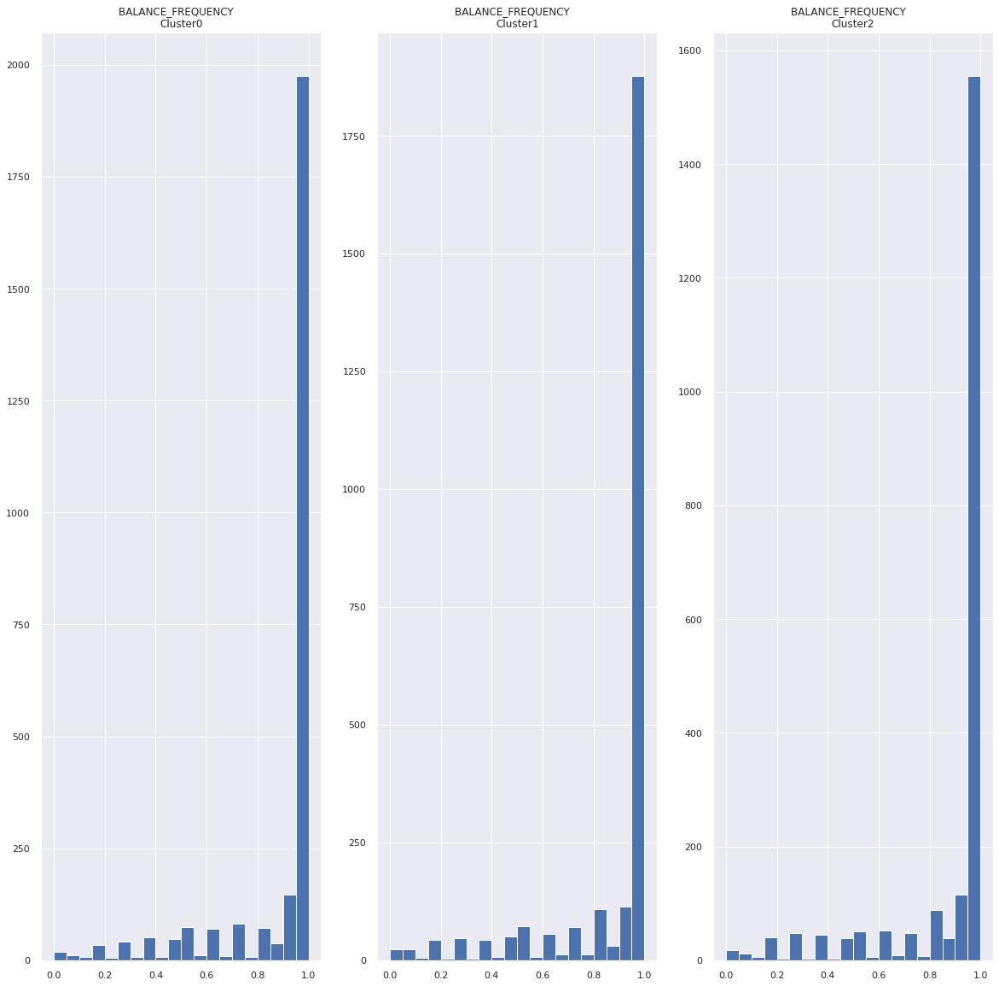

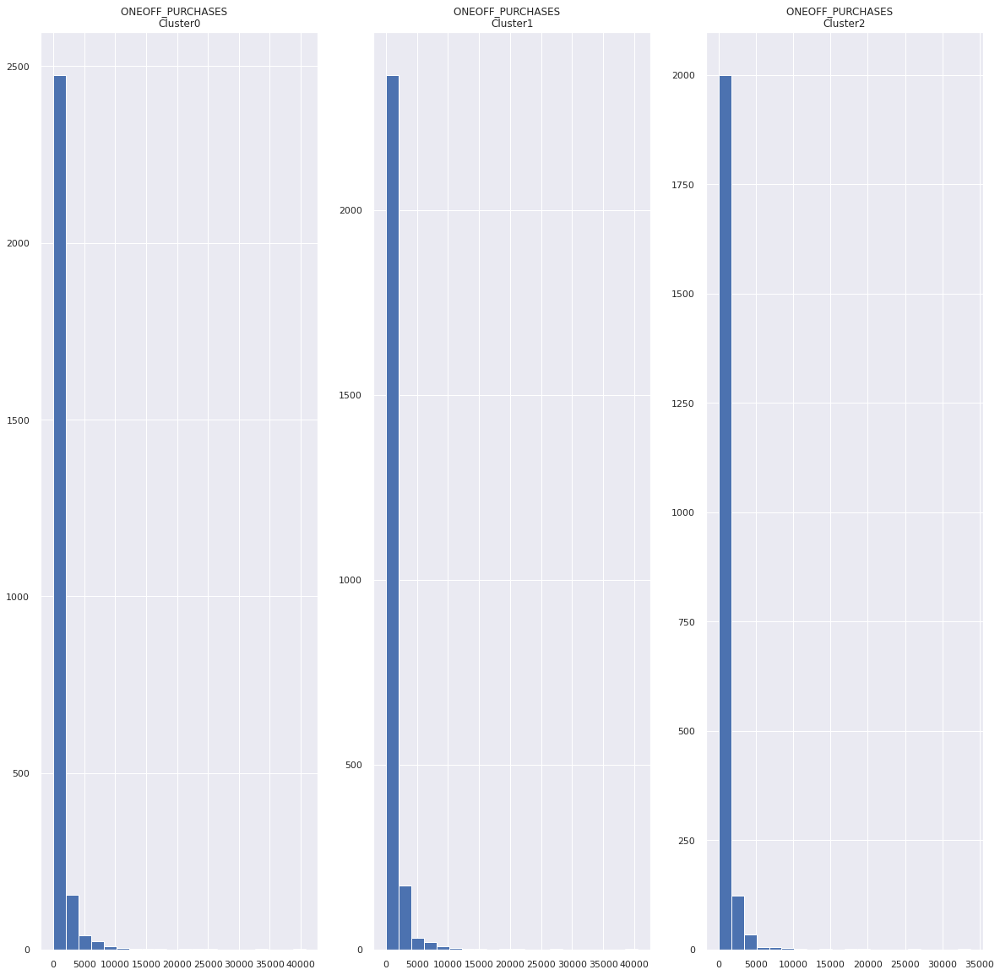

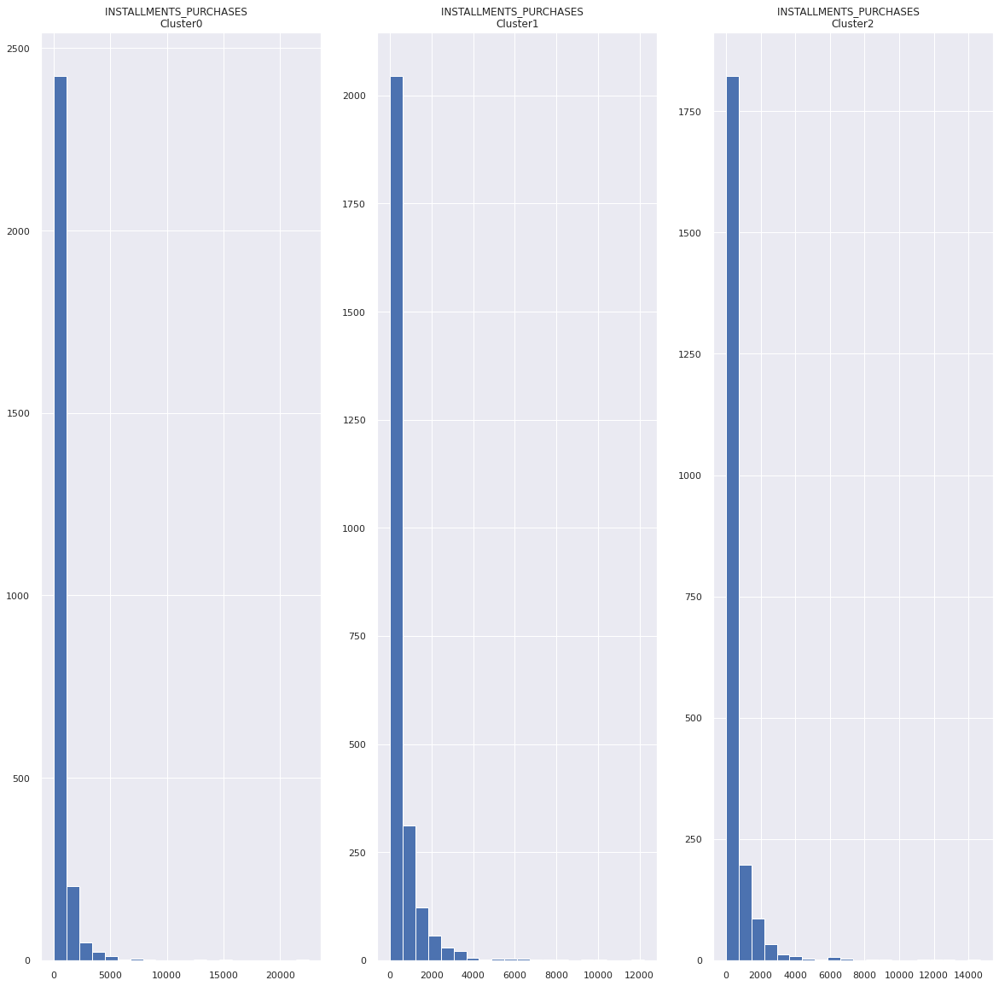

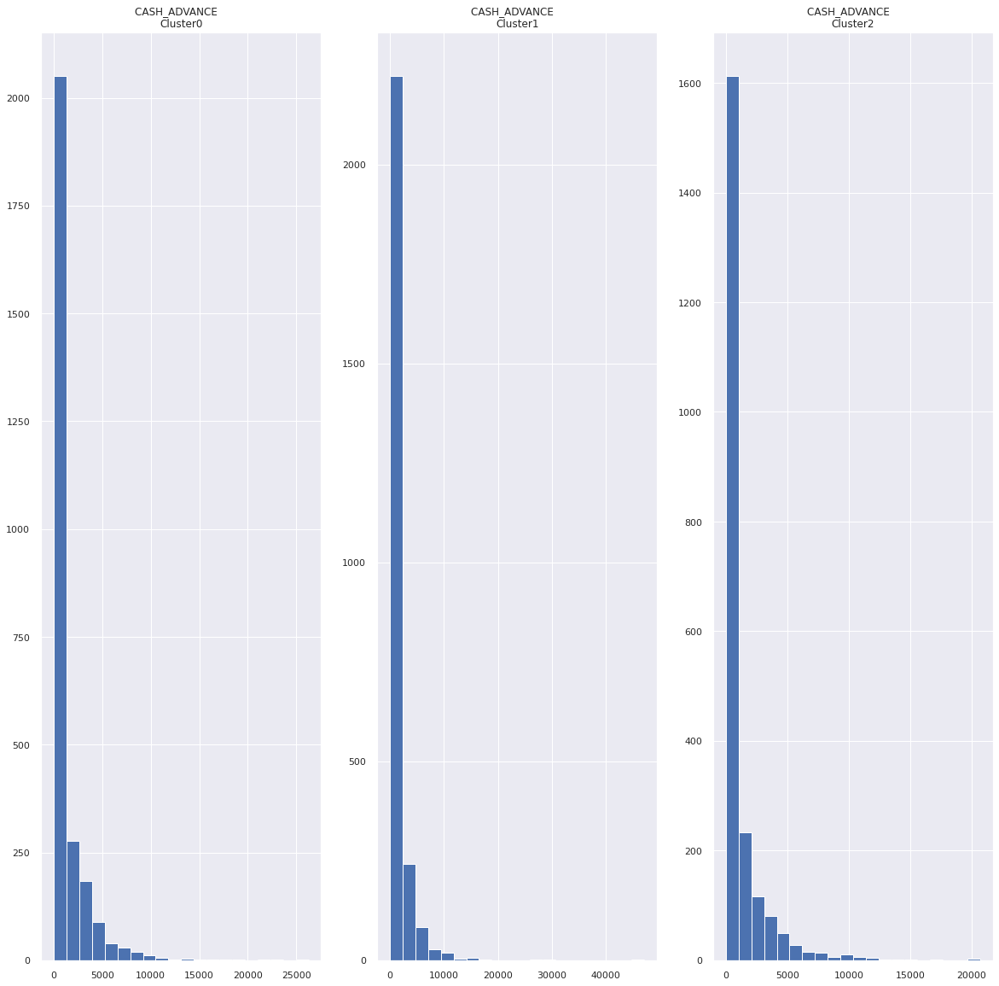

...

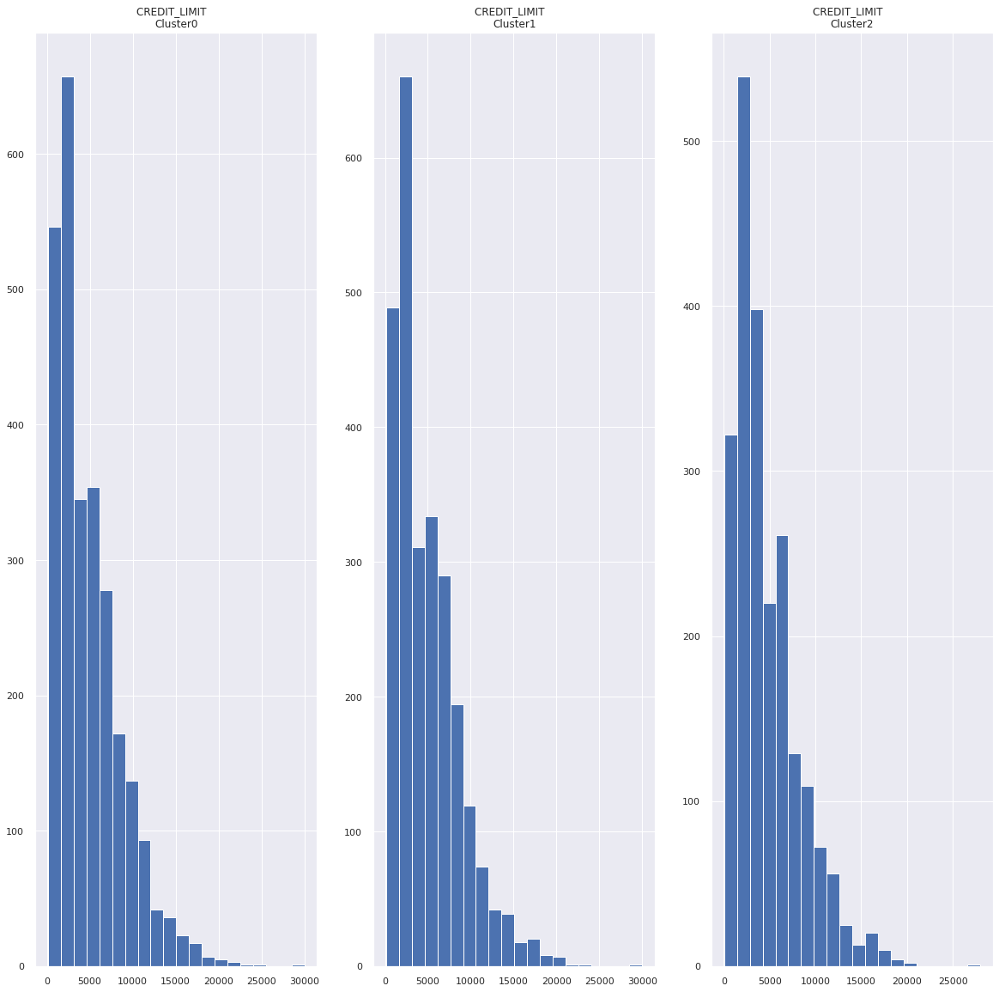

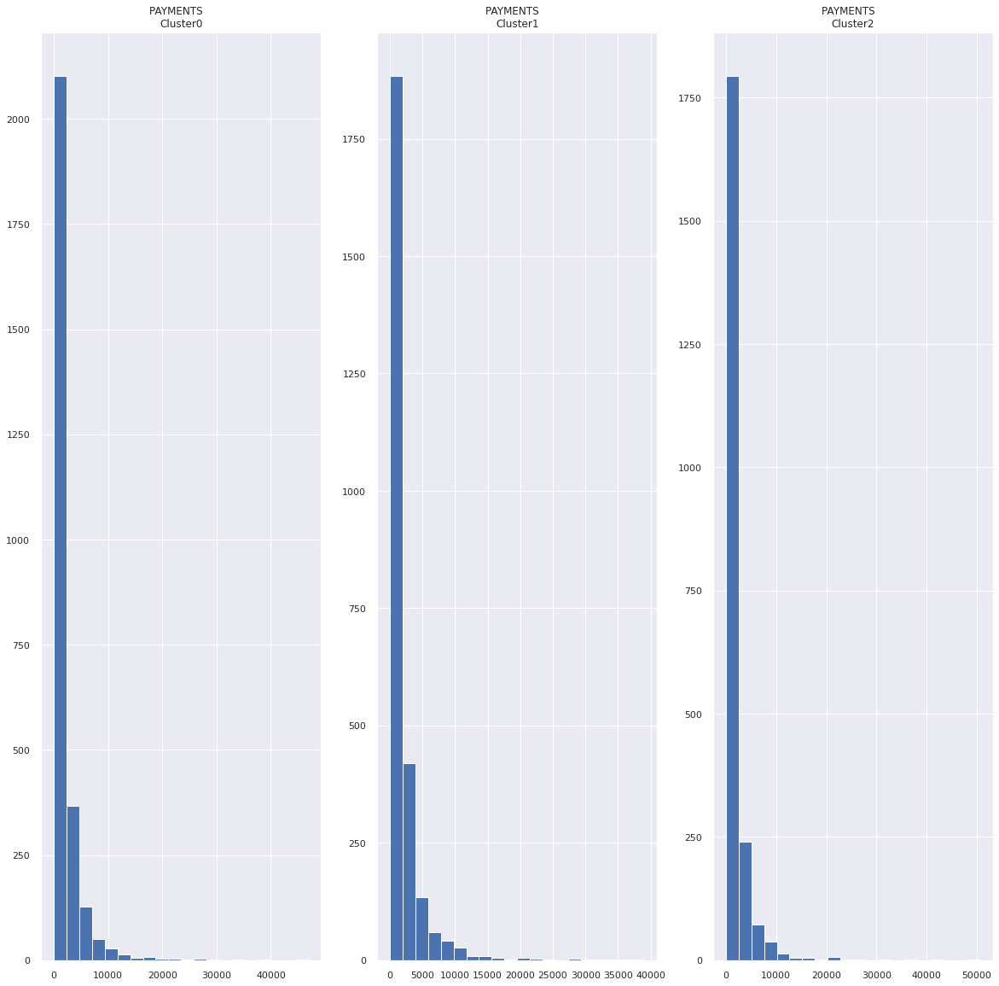

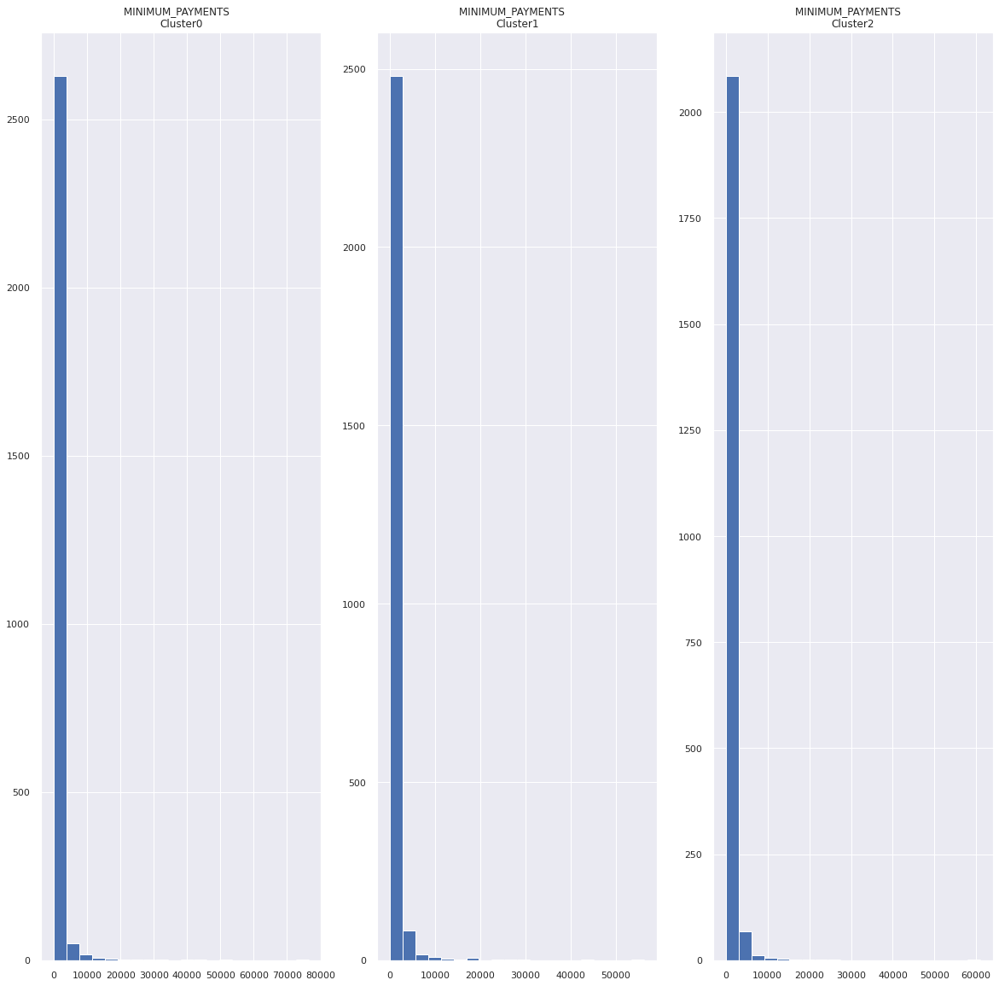

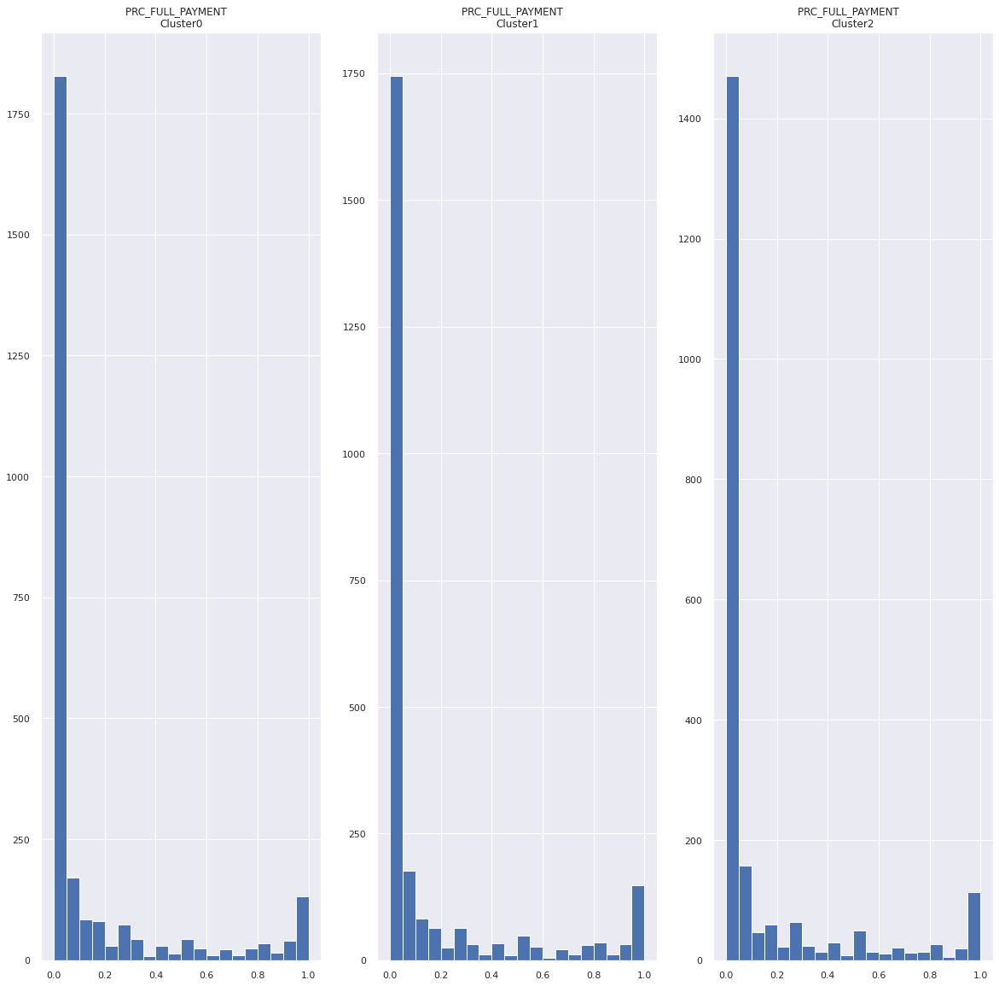

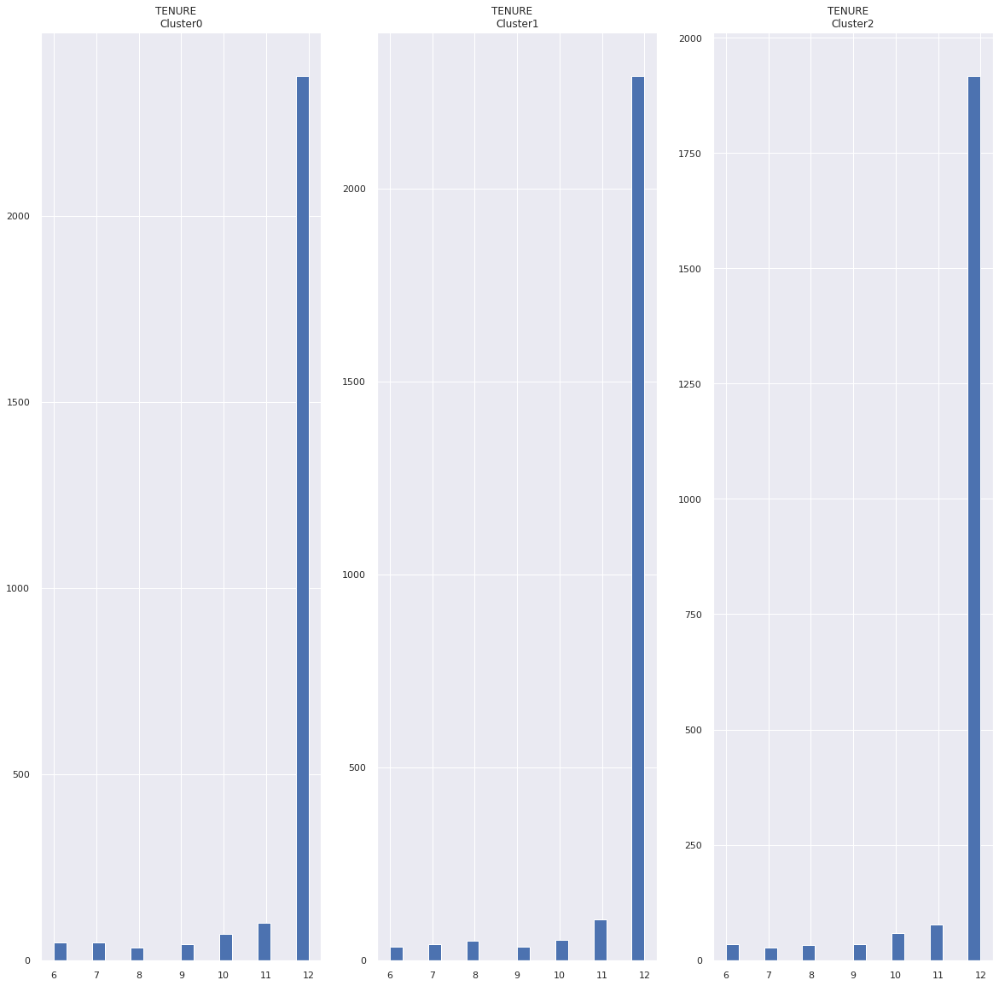

In [39]:
# plot the histogram of various clusters

for i in df.columns:
  plt.figure(figsize=(20,20))
  for j in range(3):
    plt.subplot(1, 3, j+1)
    cluster = df_cluster[df_cluster['cluster'] == j]
    cluster[i].hist(bins = 20)
    plt.title('{}   \nCluster{}'.format(i, j))
  
  plt.show()

####Apply Elbow Method to find the optimal value of K

####How to determine the value of K?

  * If we know how many classes we want to classify, then we use that value as 'k'. For Example - All of us have heard of the Iris data or even worked with it earlier. It has three classes we could classify our flowers into. So, in that case the value of k could be taken as 3.
  * If we don't know how many classes we want, then we will have to decide what the best 'k' value is. A very popular to find the value of 'k' is Elbow Method

In [40]:
inertia_list = []
for num_clusters in np.arange(1, 21):
  kmeans = KMeans(n_clusters=num_clusters)
  kmeans.fit(df_scaled)
  inertia_list.append(kmeans.inertia_)

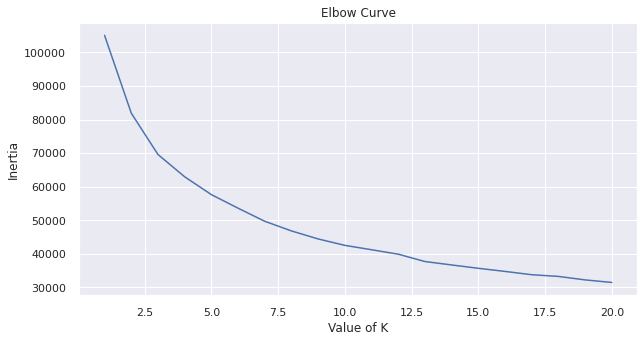

In [42]:
#Plotting the elbow curve
plt.figure(figsize=(10, 5))
plt.plot(np.arange(1, 21), inertia_list)
plt.grid(True)
plt.xlabel('Value of K')
plt.ylabel("Inertia")
plt.title("Elbow Curve")
plt.show()

From above, we select the optimum value of k by determining the Elbow Point - a point after which the inertia starts decreasing linearly. In this case, we can select the value of k as 10.

###Apply PCA and visualize the results

Principal Component Analysis(PCA) is a dimensionality reduction technique in which we extract a new set of variables from the dataset. It is one of the widely used unsupervised algorithms.

This technique can also be used for:

* visualization
* noise filtering
* feature extraction or engineering

In [43]:
# Obtain the principle component
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principal_comp = pca.fit_transform(df_scaled)
principal_comp

array([[ 0.57863943,  2.48666001],
       [-3.07516123, -0.48284547],
       [ 0.26981669, -2.02764123],
       ...,
       [-2.63535797,  2.39981826],
       [ 1.04351495,  2.03147906],
       [-2.04165579,  2.30152651]])

In [44]:
df_scaled.shape

(7507, 14)

n this example, we are using PCA to bring down the number of dimensions from 14 to 2 (n_components)

PCA has a number of parameters such as-

  * n_components- Defines the number of components you want to project your data onto.
  * random state- Fixed value which will guarantee the same sequence of random numbers are generated each time you run the code. And unless there is some other randomness present in the process, the results produced will be same as always. This helps in verifying the output.



In [45]:
# Create a dataframe with the two components
pca_df = pd.DataFrame(data=principal_comp,columns=['pca1','pca2'])
pca_df.sample(5)

,pca1,pca2
4385,2.393982,-3.368617
5851,2.088231,1.399677
529,-0.544786,-1.117447
260,1.962058,-0.213249
3717,-3.010042,-0.574176


In [46]:
new_pca_df = pca_df

In [47]:
# concatenate the clusters labels to the dataframe
pca_df = pd.concat([pca_df,pd.DataFrame({'cluster':labels})], axis=1)
pca_df.head()

,pca1,pca2,cluster
0,0.578639,2.486660,2
1,-3.075161,-0.482845,0
2,0.269817,-2.027641,1
3,-1.576845,1.273133,0
4,-0.658371,1.019274,0


In [48]:
import plotly.express as px

px.scatter(pca_df, x='pca1', y='pca2', color="cluster")

In [49]:
from sklearn.metrics import silhouette_score

# Training the model and storing the predicted cluster labels
labels_kmeans = kmeans.fit_predict(pca_df)

**Silhouette score**

* Used to evaluate the quality of clusters created using clustering algorithms such as K-Means in terms of how well samples are clustered with other samples that are similar to each other
* Calculated for each sample of different clusters
* Value ranges from -1 to 1
  * 1: Means clusters are well apart from each other and clearly distinguished.
  * 0: Means clusters are indifferent, or we can say that the distance between clusters is not significant.
  * -1: Means clusters are assigned in the wrong way

In [50]:
silhouette_score(df_scaled, labels_kmeans)

0.048485482139704994

###Hierarchial Clustering

***Understanding Hierarchical Clustering***

Hierarchical Clustering is an unsupervised learning algorithm which is used to group similar data-points in a cluster. It creates clusters that have a pre-determined order from top to bottom. For example, files and folders organized in a hierarchy on a hard-disk.

There are two types of Hierarchial Clustering:

  * **Agglomerative Hierarchial Clustering :**

It is most commonly used. It works in a bottom-up manner. Here, we assign each data-point to a individual cluster and then calculate the similarity between each of the clusters using either Eulidean Distance or Manhattan Distance and club the most similar clusters. It merges similar points of cluster and stops when all the data-points are merged into a single cluster.

  * **Divisive Hierarchial Clustering :**

It is not used much. It is the inverse of Agglomerative Hierarchial Clustering. It works in a top-down manner. Here, we assign all the data-points to a single cluster after each iteration we remove the data-points from the cluster which are not similar and each data-point that we remove is treated as an individual cluster. Here, we are dividing the cluster in every step. This is why, it is known as Divisive Hierarchial Clustering.

The Hierarchial Clustering technique can be visualized with a Dendrogram.

A dendrogram is a tree-like diagram showing hierarchical clustering. It shows the relationships between similar sets of data-points. We can also use the concept of Dendrogram to decide the number of clusters in Hieararchial Clustering.



####Getting the Dendrogram

Text(0, 0.5, 'Distance between Samples')

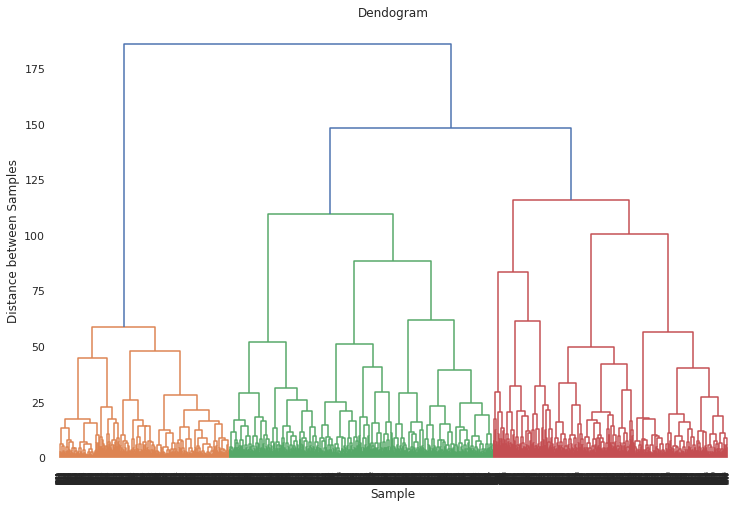

In [51]:
#This cell will take around 15 mins to run

plt.figure(figsize=(12, 8))
plt.title("Dendogram")
dendrogram = shc.dendrogram(shc.linkage(df_scaled, method='ward'))
plt.xlabel('Sample')
plt.ylabel('Distance between Samples')

####How to decide the Number of Clusters?

From above, you can see that red line has the maximum distance. We can select a threshold of 125 and the cut the dendrogram.

Text(0, 0.5, 'Distance between Samples')

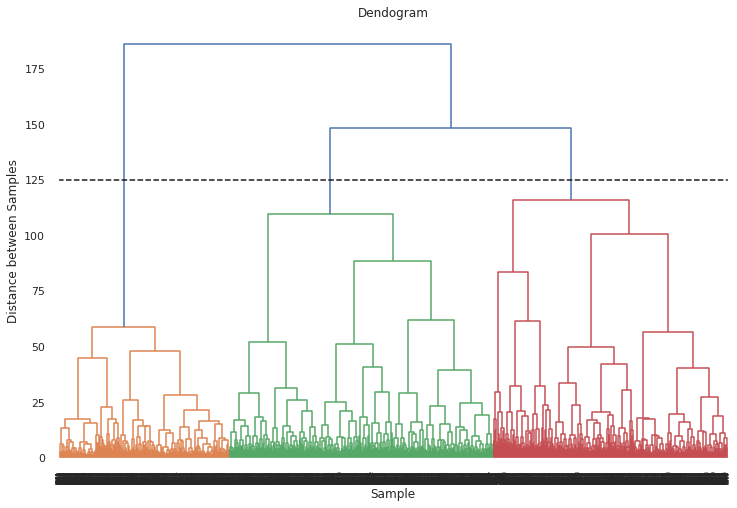

In [52]:
#This cell will take around 15 mins to run

plt.figure(figsize=(12, 8))
plt.title("Dendogram")
dendrogram = shc.dendrogram(shc.linkage(df_scaled, method='ward'))
plt.axhline(y=125, color='k', linestyle='--')
plt.xlabel('Sample')
plt.ylabel('Distance between Samples')

From above, you can see that the line cuts the dendrogram at 3 points. That means we are going to apply hierarchial clustering for 3 clusters

####Applying Hierarchial Clustering

In [54]:
#Agglomarative Hierarchial Clustering
cluster = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')

hier_label = cluster.fit_predict(df_scaled)

From above, you can see values between 0 and 4 beacuse we defined 4 clusters. 0 represents the points that belongs to the first cluster and 1 represents the points that belongs to the second cluster and so on. These values represents the cluster labels

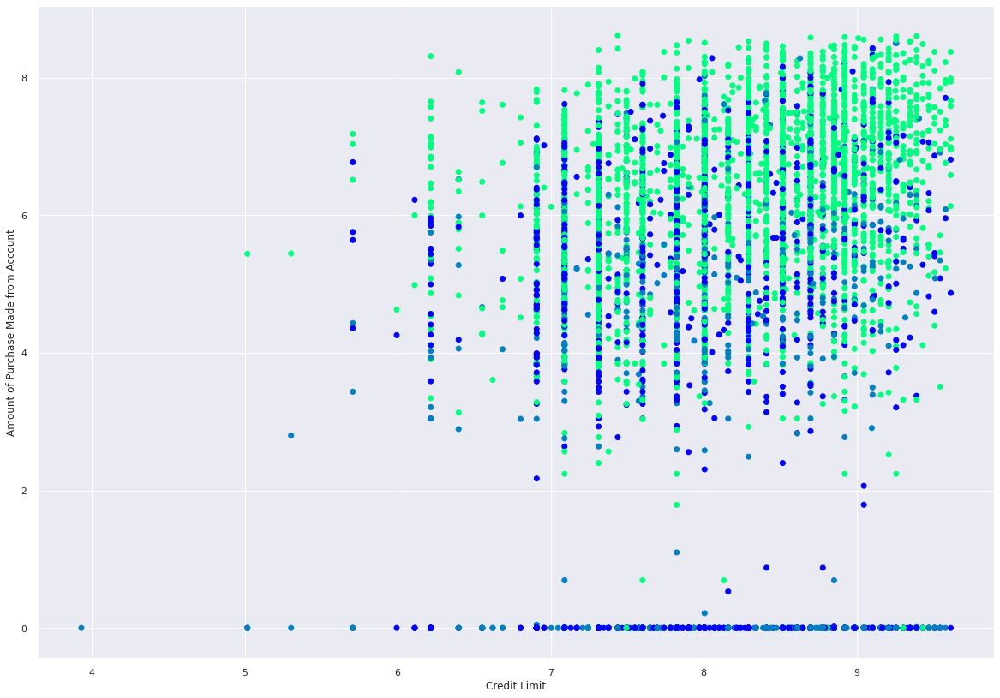

In [55]:
# Visualizing the clustering
%matplotlib inline
plt.figure(figsize=(20,14))
plt.scatter(y = df1['ONEOFF_PURCHASES'], x= df1['CREDIT_LIMIT'],
            c = cluster.labels_, cmap=plt.cm.winter)
plt.ylabel("Amount of Purchase Made from Account")
plt.xlabel("Credit Limit")
plt.show()

In [56]:
silhouette_score(df_scaled, hier_label)

0.16612284932239185

###DBSCAN Clustering

DBSCAN stands for Density-Based Spatial Clustering of Applications with Noise. This technique is one of the most common clustering algorithms which works based on density of object. The whole idea is that if a particular point belongs to a cluster, it should be near to lots of other points in that cluster.

It works based on two parameters: Epsilon and Minimum Points

* **Epsilon** determine a specified radius that if includes enough number of points within, we call it dense area
* **minimumSamples** determine the minimum number of data points we want in a neighborhood to define a cluster.

In [58]:
from sklearn.cluster import DBSCAN

epsilon = 0.3
minimumSamples = 7

db = DBSCAN(eps=epsilon, min_samples=minimumSamples)

y_pred = db.fit_predict(df_scaled)

labels = db.labels_
labels

array([-1, -1, -1, ..., -1, -1, -1])

Text(0.5, 1.0, 'DBSCAN')

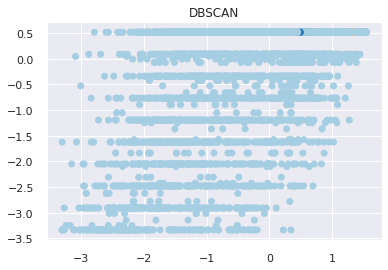

In [59]:
plt.scatter(df_scaled[:,0], df_scaled[:,1],c=y_pred, cmap='Paired')
plt.title("DBSCAN")

###Spectral Clustering

In [61]:
from sklearn.cluster import SpectralClustering

spectral_model_rbf = SpectralClustering(n_clusters=2, affinity='rbf')

labels_rbf = spectral_model_rbf.fit_predict(pca_df)

In [62]:
spectral_model_nn = SpectralClustering(n_clusters=2, affinity="nearest_neighbors")
labels_nn = spectral_model_nn.fit_predict(pca_df)

In [63]:
# List of different values of affinity
affinity = ['rbf', 'nearest-neighbours']

# list of Silhouette Score
s_scores = []

# Evaluating the performance
s_scores.append(silhouette_score(df_scaled, labels_rbf))
s_scores.append(silhouette_score(df_scaled, labels_nn))

print(s_scores)

[0.2082460979660668, 0.1788589071230976]


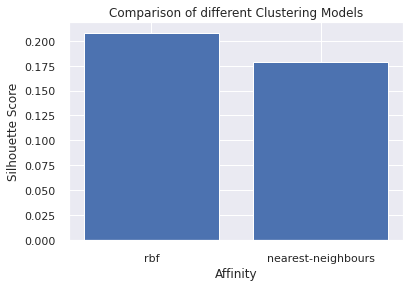

In [64]:
# Plotting a bar graph to compare the models
plt.bar(affinity, s_scores)
plt.xlabel('Affinity')
plt.ylabel("Silhouette Score")
plt.title("Comparison of different Clustering Models")
plt.show()

###PyCaret

Use PyCaret to find the best model and perform Automatic Hyperparameter tuning

PyCaret is an open source, low-code machine learning library in Python that allows you to go from preparing your data to deploying your model within minutes in your choice of notebook environment

Click Here! to learn more about PyCaret

Installing PyCaret

!pip install pycaret
####Tasks to be performed

* Import PyCaret and load the data set
* Initialize or setup the environment
* Create the model
* Assign the model
* Plot the model

####Import PyCaret and load the data set

In [66]:
#!pip install pycaret

     |████████████████████████████████| 266 kB 5.3 MB/s 
     |████████████████████████████████| 261 kB 51.4 MB/s 
     |████████████████████████████████| 86 kB 5.0 MB/s 
     |████████████████████████████████| 1.3 MB 32.9 MB/s 
     |████████████████████████████████| 16.9 MB 42 kB/s 
     |████████████████████████████████| 25.9 MB 1.0 kB/s 
     |████████████████████████████████| 1.7 MB 42.4 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 56 kB 4.4 MB/s 
     |████████████████████████████████| 6.8 MB 21.4 MB/s 
     |████████████████████████████████| 2.0 MB 48.0 MB/s 
     |████████████████████████████████| 113 kB 74.1 MB/s 
     |████████████████████████████████| 167 kB 50.9 MB/s 
     |████████████████████████████████| 271 kB 58.3 MB/s 
     |████████████████████████████████| 10.1 MB 24.8 MB/s 
     |██████████████████

In [1]:
import pycaret.clustering as pc
#dir(pc)

In [2]:
from pycaret.clustering import *

clu1 = setup(df, normalize = True, session_id = 123)

NameError: ignored

####Create the Model

Creates a model on the dataset passed as a data param during the setup stage
setup() function must be called before using create_model()
Returns a trained model object